# Partie 1 : Récolte des données

## 1 - Importer les données

In [301]:
%pip install earthpy


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [302]:
from glob import glob
import os
import pandas as pd

import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep

import rasterio as rio

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

import plotly.graph_objects as go

In [303]:
# Choix du format des données à importer
s2_sentinel_bands = glob("R2023/*B*.jp2") # B tif pour préciser quel format de fichier on prend !
s2_sentinel_bands_2 = glob("R2017/*B*.jp2") # B tif pour préciser quel format de fichier on prend !

s2_sentinel_bands_2, s2_sentinel_bands

(['R2017\\L2A_T30TXR_20170218T110111_B02_10m.jp2',
  'R2017\\L2A_T30TXR_20170218T110111_B03_10m.jp2',
  'R2017\\L2A_T30TXR_20170218T110111_B04_10m.jp2',
  'R2017\\L2A_T30TXR_20170218T110111_B08_10m.jp2'],
 ['R2023\\T30TXR_20230528T105621_B02_10m.jp2',
  'R2023\\T30TXR_20230528T105621_B03_10m.jp2',
  'R2023\\T30TXR_20230528T105621_B04_10m.jp2',
  'R2023\\T30TXR_20230528T105621_B08_10m.jp2'])

In [304]:
#Visualisation de la bande 2
src = rio.open("R2023/T30TXR_20230528T105621_B02_10m.jp2")
src_2 = rio.open("R2017/L2A_T30TXR_20170218T110111_B02_10m.jp2")

In [305]:
type(src) #stocker la variable
type(src_2) #stocker la variable

rasterio.io.DatasetReader

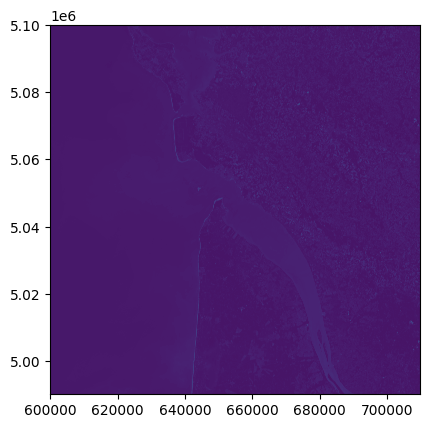

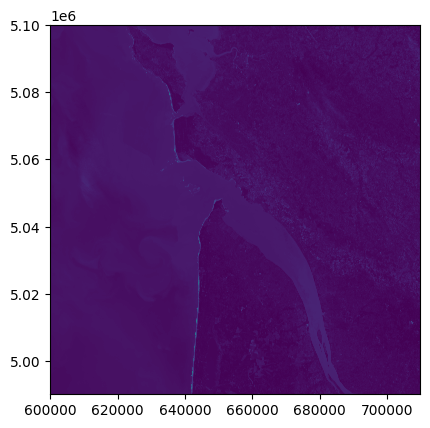

(<Axes: >, <Axes: >)

In [306]:
from rasterio.plot import show
show(src), show(src_2)

In [307]:
# Stocker les 4 bandes
stacked_s2_sentinel = []
stacked_s2_sentinel_2 = []

In [308]:
for img in s2_sentinel_bands: #boucle for pour parcourir toutes les images qui sont dans le dossier
    with rio.open(img, 'r') as f:
        stacked_s2_sentinel.append(f.read(1))

for img in s2_sentinel_bands_2: #boucle for pour parcourir toutes les images qui sont dans le dossier
    with rio.open(img, 'r') as f:
        stacked_s2_sentinel_2.append(f.read(1))

In [309]:
len(stacked_s2_sentinel) #calcul du nombre de bandes
len(stacked_s2_sentinel_2) #calcul du nombre de bandes

4

In [310]:
# Stack the 4 individual bands into an n-d array-
stacked_s2_sentinel_img = np.stack(stacked_s2_sentinel)
stacked_s2_sentinel_img_2 = np.stack(stacked_s2_sentinel_2)

In [311]:
stacked_s2_sentinel_img.shape

(4, 10980, 10980)

In [312]:
stacked_s2_sentinel_img_2.shape

(4, 10980, 10980)

## 2 - Réduire la taille des images (qui sont trop lourdes)

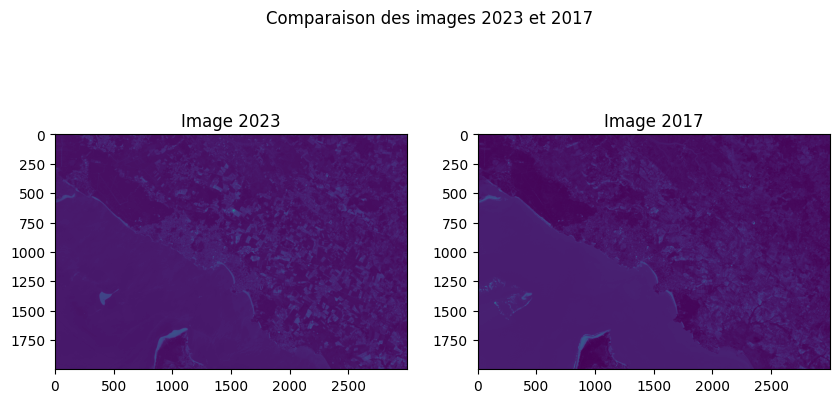

In [313]:
import rasterio
from rasterio.windows import Window

# Spécifiez les coordonnées de la fenêtre de découpage
window = Window(col_off=4000, row_off=3500, width=3000, height=2000)  # Ajustez les valeurs en conséquence

# Chargez l'image complète
with rio.open("R2023/T30TXR_20230528T105621_B02_10m.jp2") as src:
    subset = src.read(1, window=window)

with rio.open("R2017/L2A_T30TXR_20170218T110111_B02_10m.jp2") as src_2:
    subset_2 = src_2.read(1, window=window)



# Affichez la région découpée

# Créez une figure avec deux sous-graphiques
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Affichez la première image dans le premier sous-graphique
axes[0].imshow(subset, cmap='viridis')
axes[0].set_title('Image 2023')

# Affichez la deuxième image dans le deuxième sous-graphique
axes[1].imshow(subset_2, cmap='viridis')
axes[1].set_title('Image 2017')

# Ajoutez un titre pour l'ensemble de la figure
fig.suptitle('Comparaison des images 2023 et 2017')

# Affichez la figure
plt.show()

In [314]:
#Appliquer la même taille à toutes les images
# Stocker les 4 bandes
subset_stack = []

for img in s2_sentinel_bands: #boucle for pour parcourir toutes les images qui sont dans le dossier
    with rio.open(img, 'r') as f:
        subset_stack.append(f.read(1, window=window))

subset_stack_2 = []

for img in s2_sentinel_bands_2: #boucle for pour parcourir toutes les images qui sont dans le dossier
    with rio.open(img, 'r') as f:
        subset_stack_2.append(f.read(1, window=window))
        
len(subset_stack)

4

In [315]:
subset_stack_img = np.stack(subset_stack)
subset_stack_img_2 = np.stack(subset_stack_2)
subset_stack_img_2.shape, subset_stack_img.shape

((4, 2000, 3000), (4, 2000, 3000))

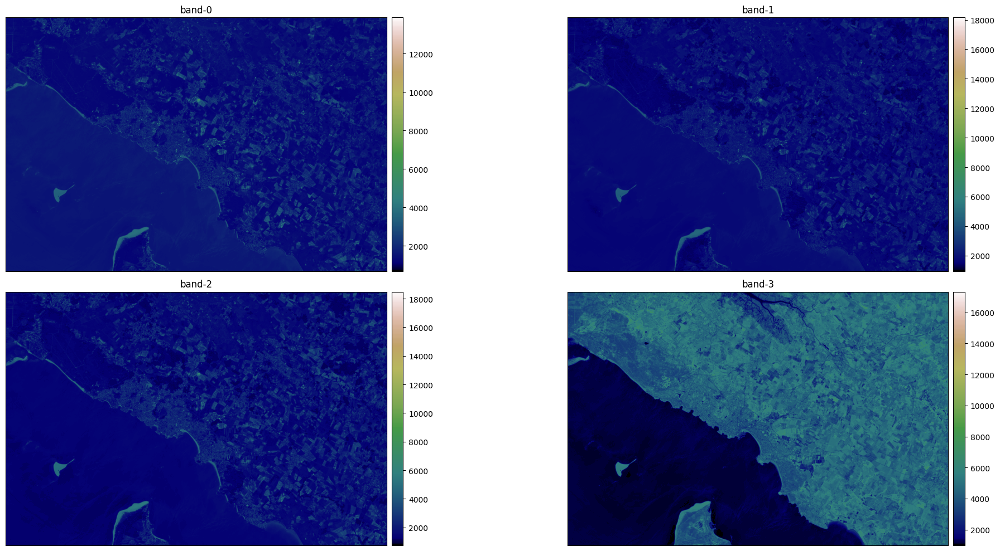

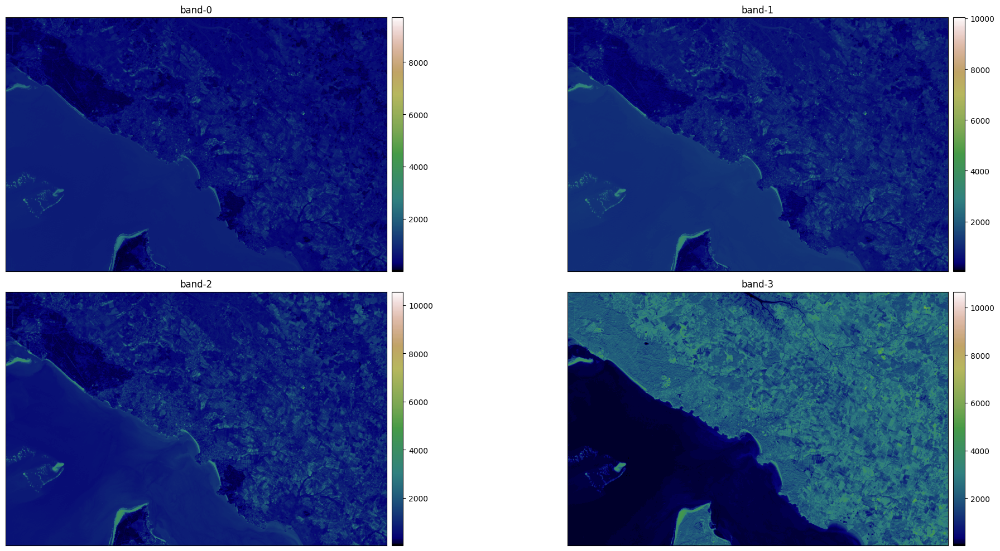

In [316]:
titles = [f'band-{i}' for i in range(0, 4)]
ep.plot_bands(
    arr = subset_stack_img, cmap = 'gist_earth',
    figsize = (22, 10), cols = 2,
    cbar = True, title = titles)

titles2 = [f'band-{i}' for i in range(0, 4)]
ep.plot_bands(
    arr = subset_stack_img_2, cmap = 'gist_earth',
    figsize = (22, 10), cols = 2,
    cbar = True, title = titles)
plt.show()

# Partie 2 : Un peu de stats :) 

## 1 - stats

In [317]:
subset_stack_img_divided = subset_stack_img / 10000
subset_stack_img_divided_2 = subset_stack_img_2 / 10000

In [318]:
subset_stack_img_divided.shape, subset_stack_img_divided_2.shape

((4, 2000, 3000), (4, 2000, 3000))

In [319]:
subset_stack_img.min(), subset_stack_img.max(), subset_stack_img_2.min(), subset_stack_img_2.max()

(695, 18480, 1, 10650)

In [320]:
subset_stack_img_divided.min(), subset_stack_img_divided.max(), subset_stack_img_divided_2.min(), subset_stack_img_divided_2.max()

(0.0695, 1.848, 0.0001, 1.065)

In [321]:
# Normalize image
normalized_img = (subset_stack_img - subset_stack_img.min()) / (subset_stack_img.max() - subset_stack_img.min())
normalized_img_2 = (subset_stack_img_2 - subset_stack_img_2.min()) / (subset_stack_img_2.max() - subset_stack_img_2.min())

In [322]:
normalized_img.min(), normalized_img.max(), normalized_img_2.min(), normalized_img_2.max() 

(0.0, 1.0, 0.0, 1.0)

## 2 - Visualisation des bandes

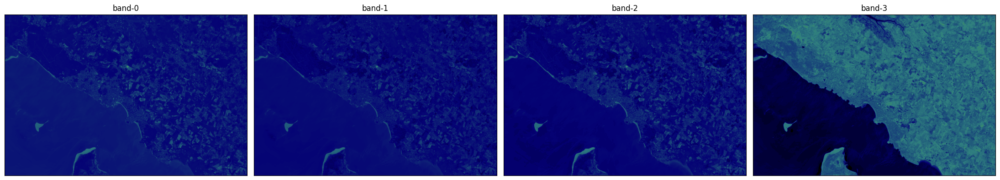

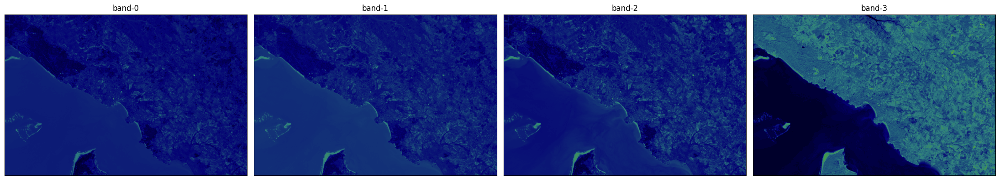

In [323]:
# Visualize each of the 4 bands (divised)
ep.plot_bands(
    arr = subset_stack_img_divided, cmap = 'gist_earth',
    figsize = (22, 10), cols = 4,
    cbar = False, title = titles)

ep.plot_bands(
    arr = subset_stack_img_divided_2, cmap = 'gist_earth',
    figsize = (22, 10), cols = 4,
    cbar = False, title = titles)
plt.show()

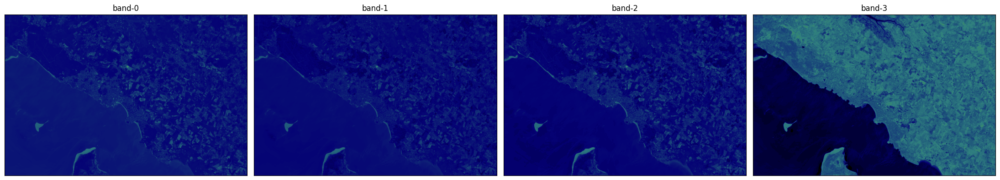

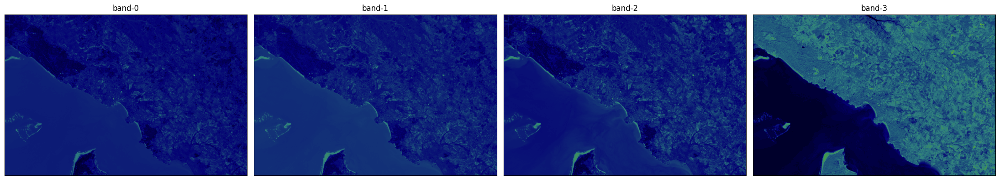

In [324]:
# Visualize each of the 4 bands using normalized image-
ep.plot_bands(
    arr = normalized_img, cmap = 'gist_earth',
    figsize = (22, 10), cols = 4,
    cbar = False, title = titles)
ep.plot_bands(
    arr = normalized_img_2, cmap = 'gist_earth',
    figsize = (22, 10), cols = 4,
    cbar = False, title = titles)
plt.show() #images normalisées

## 3 - RGB composite image

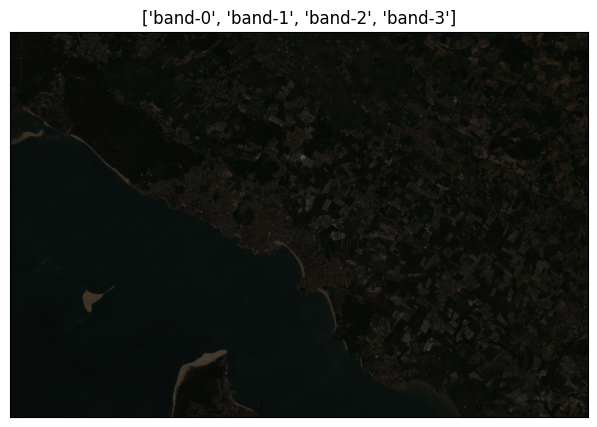

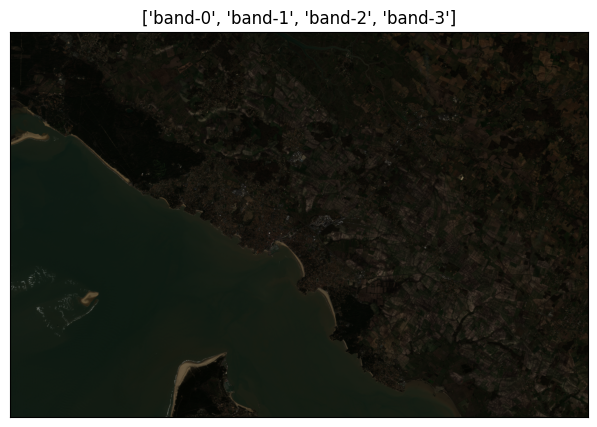

In [325]:
# Plot RGB composite image-
rgb = ep.plot_rgb(
    arr = subset_stack_img, rgb = (2, 1, 0),#position O rouge,position 1 vert, position 2 Bleu. Pour avoir la composition vraie couleur il faut faire correspondre les valeur à entrer dans les parenthese par la couleur des bande : RVB : 210
    figsize =(10, 5) , title = titles)
rgb_2 = ep.plot_rgb(
    arr = subset_stack_img_2, rgb = (2, 1, 0),#position O rouge,position 1 vert, position 2 Bleu. Pour avoir la composition vraie couleur il faut faire correspondre les valeur à entrer dans les parenthese par la couleur des bande : RVB : 210
    figsize =(10, 5) , title = titles)

plt.show()

In [326]:
# Create a numpy array copy
sentinel_img = np.copy(subset_stack_img)
sentinel_img_2 = np.copy(subset_stack_img_2)

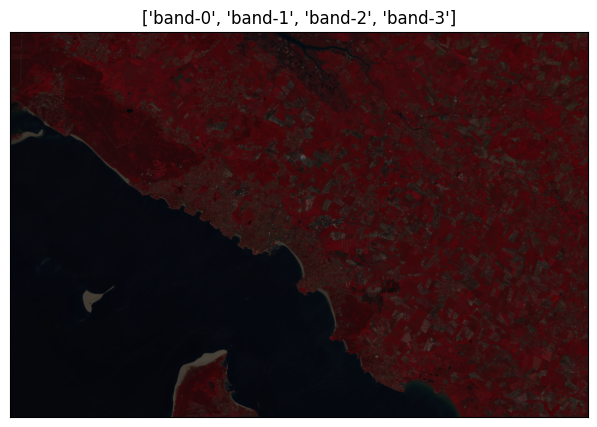

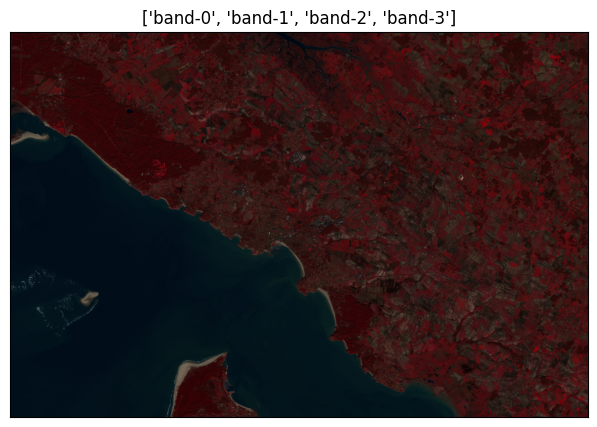

In [327]:
rgb = ep.plot_rgb(
    arr = normalized_img, rgb = (3, 2, 1),#fausses couleurs car 321 et non 210
    figsize =(10, 5) , title = titles)
rgb_2 = ep.plot_rgb(
    arr = normalized_img_2, rgb = (3, 2, 1),#fausses couleurs car 321 et non 210
    figsize =(10, 5) , title = titles)

plt.show()

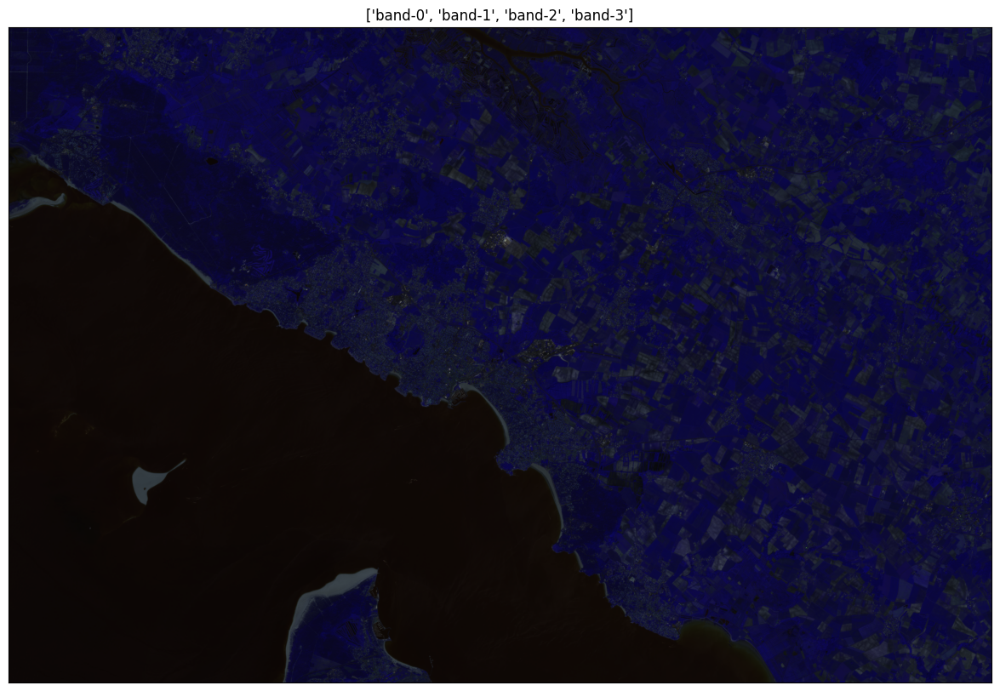

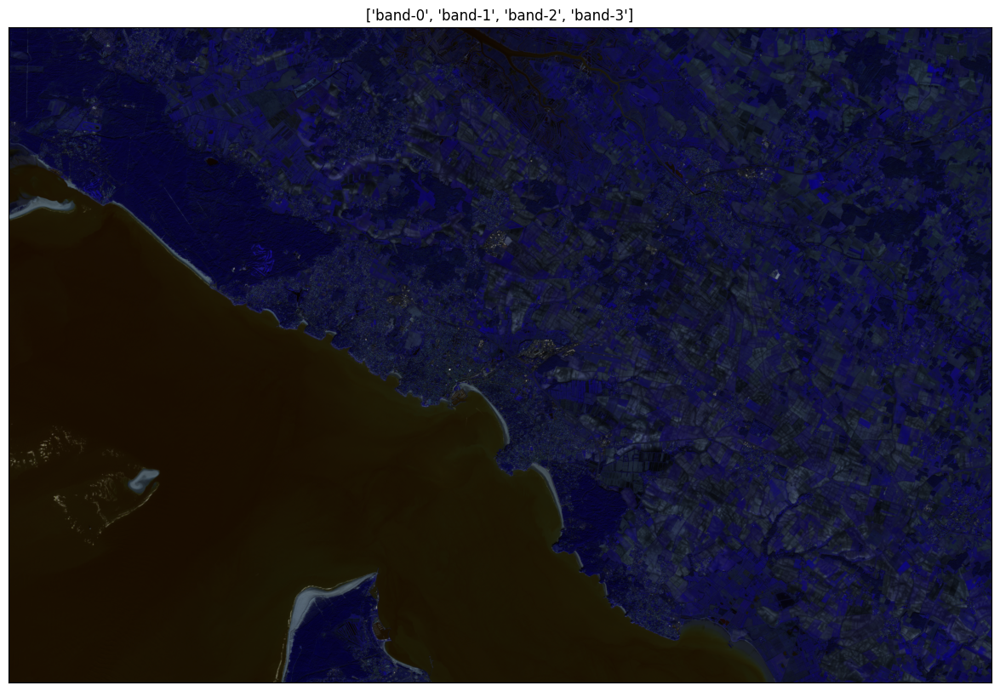

In [328]:
rgb = ep.plot_rgb(
    arr = normalized_img, rgb = (1, 2, 3),#fausse compo
    figsize =(20, 10) , title = titles)
rgb_2 = ep.plot_rgb(
    arr = normalized_img_2, rgb = (1, 2, 3),#fausse compo
    figsize =(20, 10) , title = titles)

plt.show()

Eclairer les images avec stretch

Il peut arriver que l'image composite RVB créée soit sombre en raison de l'asymétrie de la luminosité des pixels vers les valeurs 0. Pour remédier à ce problème, les valeurs de luminosité des pixels de l'image peuvent être étirées à l'aide du paramètre "stretch = True". Ce paramètre extrapole les valeurs de luminosité des pixels sur l'ensemble de la plage de valeurs 0-255 afin d'essayer d'augmenter le contraste de l'image.

Le paramètre "str_clip" spécifie la quantité de queues de données à couper.

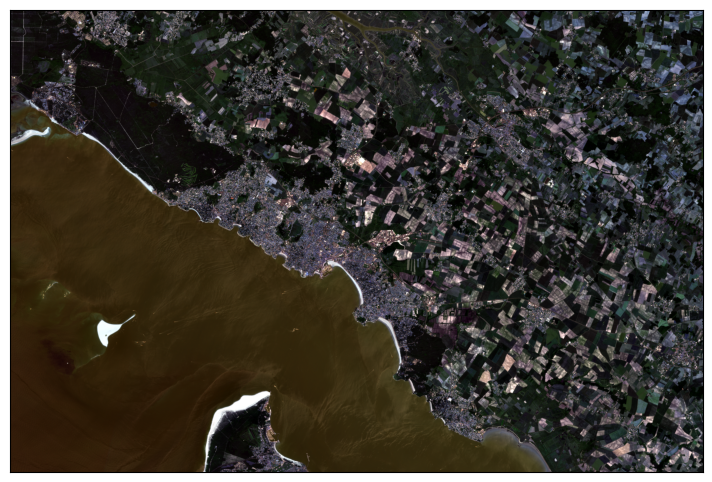

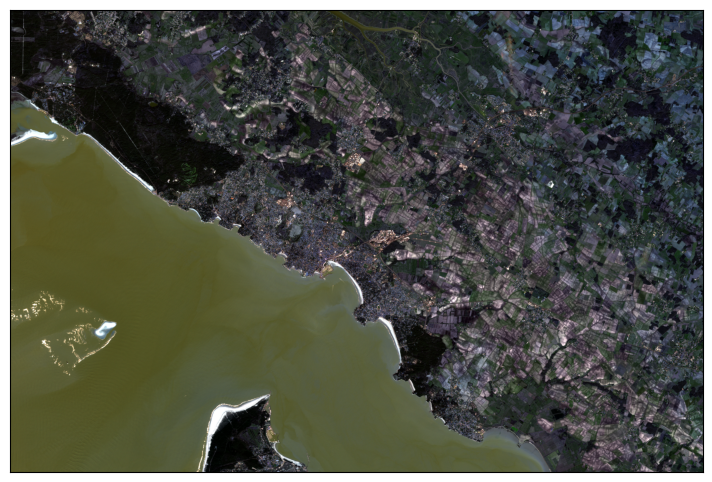

In [329]:
# RGB composite image with stretch
rgb_stretch = ep.plot_rgb(
        arr = subset_stack_img, rgb = (0, 1, 2), #fausse couleurs
        stretch = True, str_clip = 0.3,#contraste : permet de faire apparaitre un contraste c'est bcp plus clair
        figsize =(10, 6)
        )

rgb_stretch_2 = ep.plot_rgb(
        arr = subset_stack_img_2, rgb = (0, 1, 2), #fausse couleurs
        stretch = True, str_clip = 0.3,#contraste : permet de faire apparaitre un contraste c'est bcp plus clair
        figsize =(10, 6)
        )

plt.show()

# Partie 3 : Indices

## 1 - Histogrammes

In [330]:
colors = ['tomato', 'navy', 'MediumSpringGreen', 'lightblue']

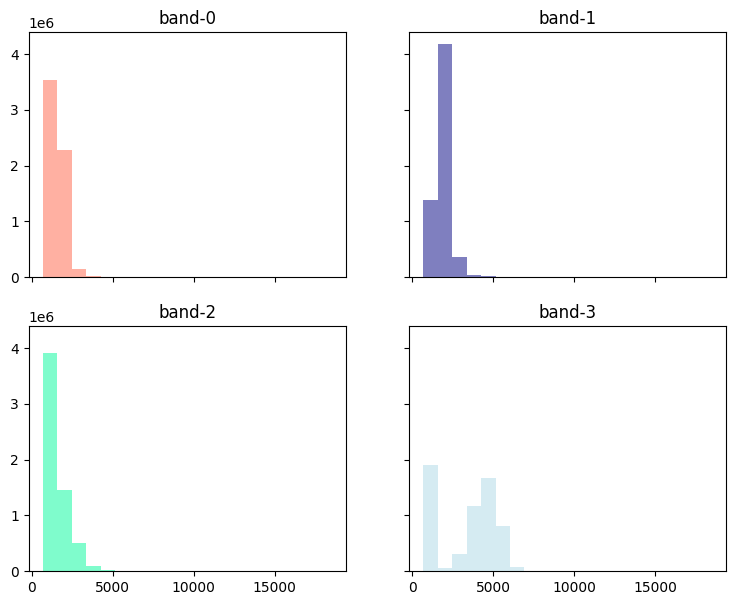

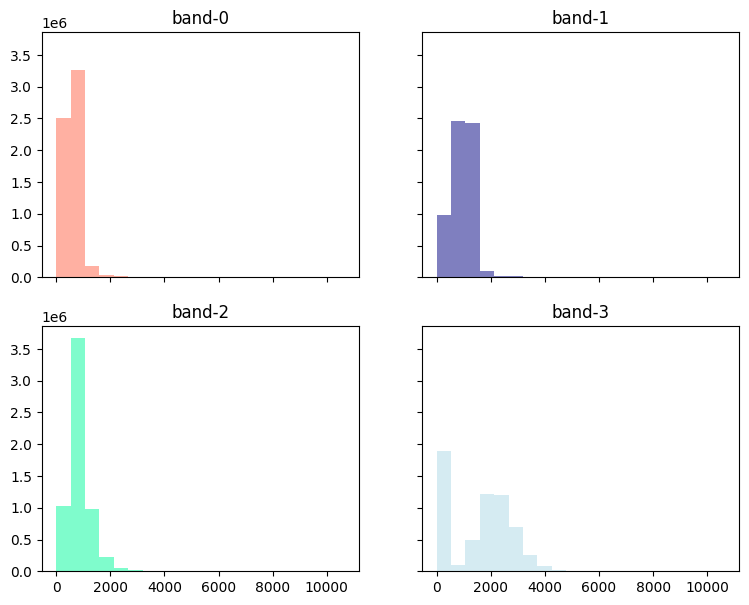

In [331]:
ep.hist(
        arr = subset_stack_img, colors = colors,
        title = titles, cols = 2,
        alpha = 0.5, figsize = (9, 7)
        )
ep.hist(
        arr = subset_stack_img_2, colors = colors,
        title = titles, cols = 2,
        alpha = 0.5, figsize = (9, 7)
        )

plt.show()

## 2 - Normalized Difference Vegetation-mer-urbanisme

Pour déterminer la végétation verte dans une image, il faut analyser des longueurs d'onde spécifiques du visible et du proche infrarouge (NIR) réfléchies par les plantes.
Le NDVI calcule cette végétation désirée comme la différence entre le proche infrarouge (fortement réfléchi par la végétation) et la lumière rouge (absorbée par la végétation).

NDVI \n- \n- \n- \n- \n- \n- \n- \n-(-1, +1\n- \n-)$

NDVI = \frac{NIR - Rouge}{NIR + Rouge}$

Pour les valeurs négatives, il s'agit probablement d'eau. En revanche, pour les valeurs proches de +1, il s'agit probablement de feuilles vertes et denses. Enfin, des valeurs proches de zéro peuvent indiquer une zone urbanisée qui n'a pas beaucoup de feuilles vertes.

In [332]:
ndvi = es.normalized_diff(subset_stack_img[3], subset_stack_img[2])
ndvi_2 = es.normalized_diff(subset_stack_img_2[3], subset_stack_img_2[2])
# ndvi = es.normalized_diff(arr_st[7], arr_st[3])

In [333]:
ndvi.min(), ndvi.max(), ndvi_2.min(), ndvi_2.max()

(0.0, 30.591397849462364, 0.0, 404.08641975308643)

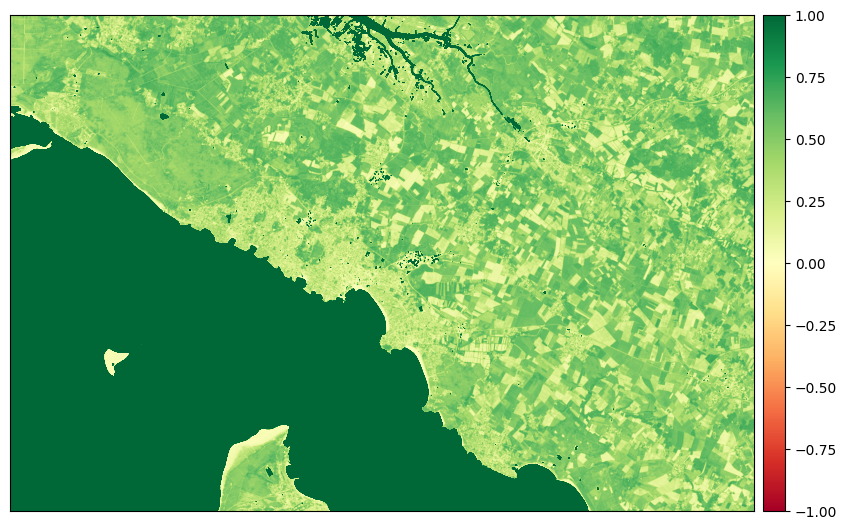

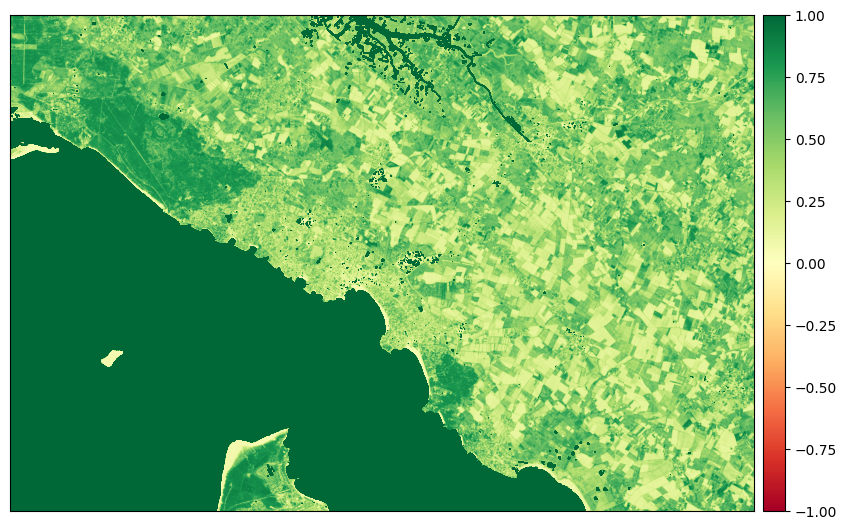

In [334]:
ep.plot_bands(
    arr = ndvi, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (10, 14)
)

ep.plot_bands(
    arr = ndvi_2, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (10, 14)
)


plt.show()

## 3 - Soil Adjusted Vegetation Index (SAVI)

In [335]:
L = 0.4

savi = ((subset_stack_img[3] - subset_stack_img[2]) / (subset_stack_img[3] + subset_stack_img[2] + L)) * (1 + L)
savi_2 = ((subset_stack_img_2[3] - subset_stack_img_2[2]) / (subset_stack_img_2[3] + subset_stack_img_2[2] + L)) * (1 + L)

In [336]:
savi.min(), savi.max(), savi_2.min(), savi_2.max()

(0.0, 42.8199495185566, 0.0, 564.3275862068965)

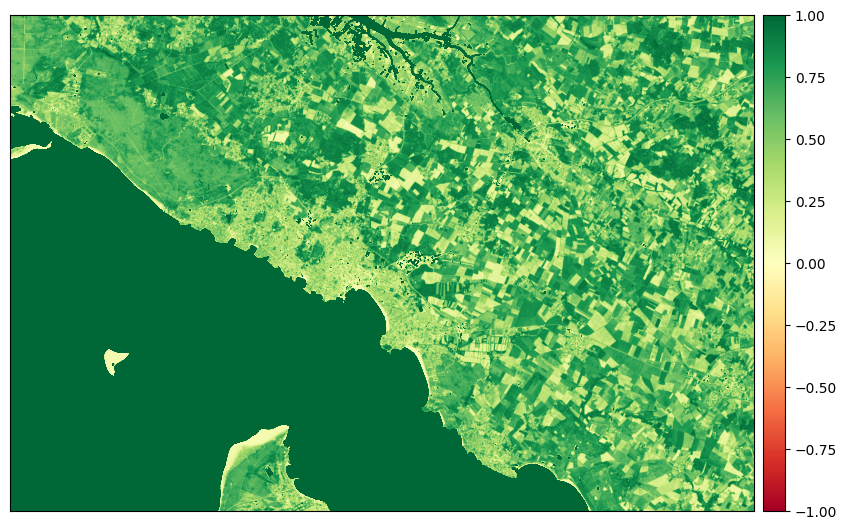

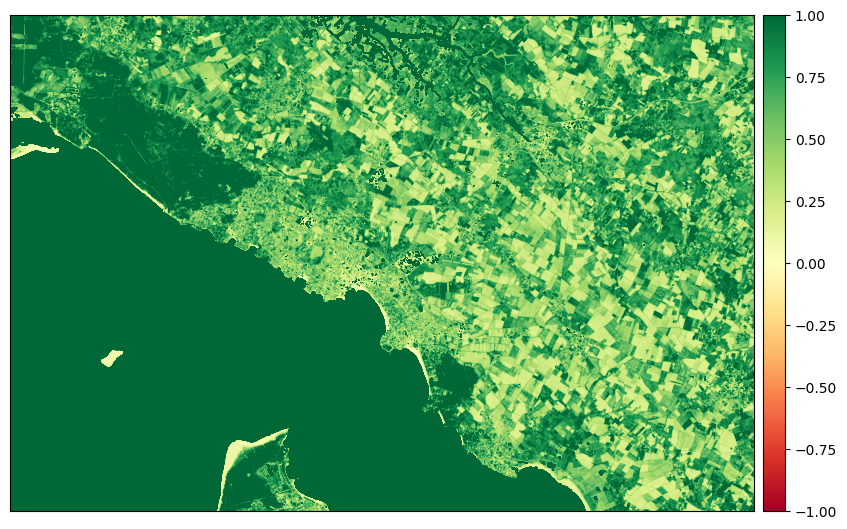

In [337]:
ep.plot_bands(
    arr = savi, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    # cols = 1, vmin = 0, vmax = 20851.73,
    figsize = (10, 14)
)

ep.plot_bands(
    arr = savi_2, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    # cols = 1, vmin = 0, vmax = 20851.73,
    figsize = (10, 14)
)

plt.show()

## 4 - Visible Atmospherically Resistant Index (VARI):

In [338]:
vari = (subset_stack_img[1] - subset_stack_img[2]) / (subset_stack_img[1] + subset_stack_img[2] - subset_stack_img[0])
vari_2 = (subset_stack_img_2[1] - subset_stack_img_2[2]) / (subset_stack_img_2[1] + subset_stack_img_2[2] - subset_stack_img_2[0])

In [339]:
vari.min(), vari.max(), vari_2.min(), vari_2.max()

(0.0, 60.9622641509434, 0.0, 910.0694444444445)

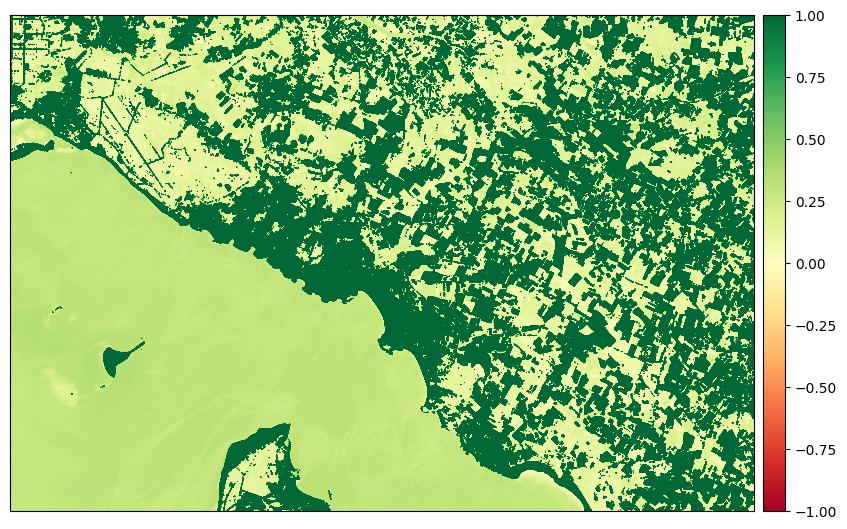

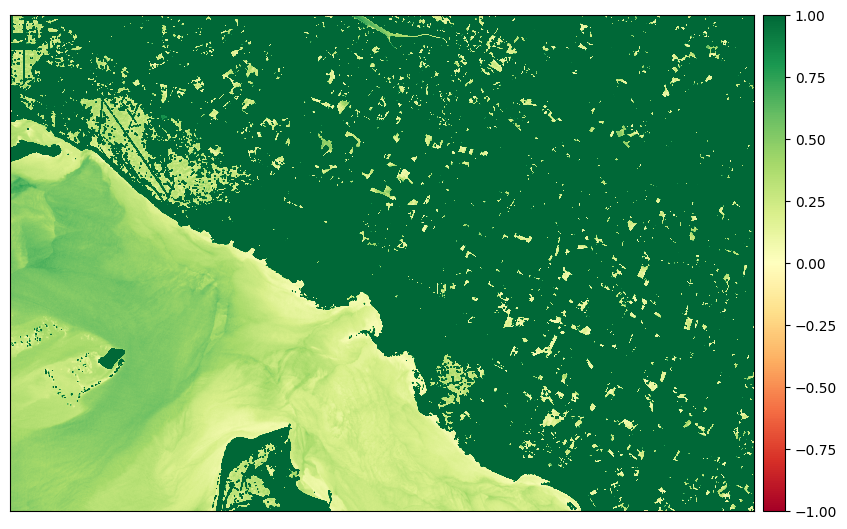

In [340]:
ep.plot_bands(
    arr = vari, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (10, 14)
)

ep.plot_bands(
    arr = vari_2, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (10, 14)
)


plt.show()

## 5 - Water Indices

In [341]:
mndwi = es.normalized_diff(subset_stack_img[1], subset_stack_img[3])
mndwi_2 = es.normalized_diff(subset_stack_img_2[1], subset_stack_img_2[3])

In [342]:
mndwi.min(), mndwi.max(), mndwi_2.min(), mndwi_2.max()

(0.0, 28.778656126482215, 0.0, 281.9568965517241)

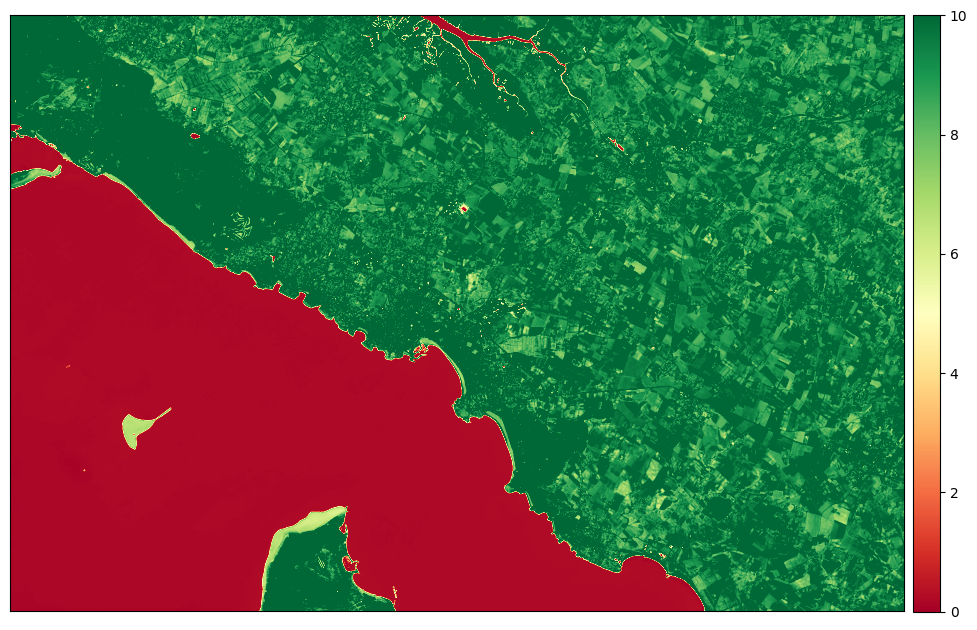

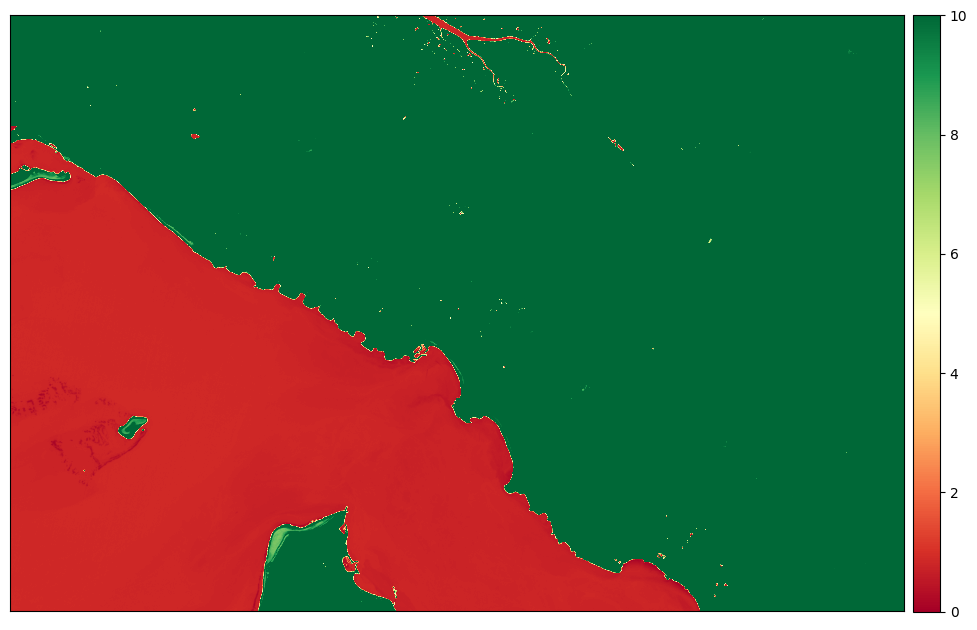

In [343]:
ep.plot_bands(
    arr = mndwi, cmap = "RdYlGn",
    cols = 1, vmin = 0, vmax = 10,
    figsize = (12, 10)
)
ep.plot_bands(
    arr = mndwi_2, cmap = "RdYlGn",
    cols = 1, vmin = 0, vmax = 10,
    figsize = (12, 10)
)
plt.show()

## 6 - Normalized Difference Moisture Index

In [344]:
ndmi = es.normalized_diff(subset_stack_img[3], subset_stack_img[2])
ndmi_2 = es.normalized_diff(subset_stack_img_2[3], subset_stack_img_2[2])

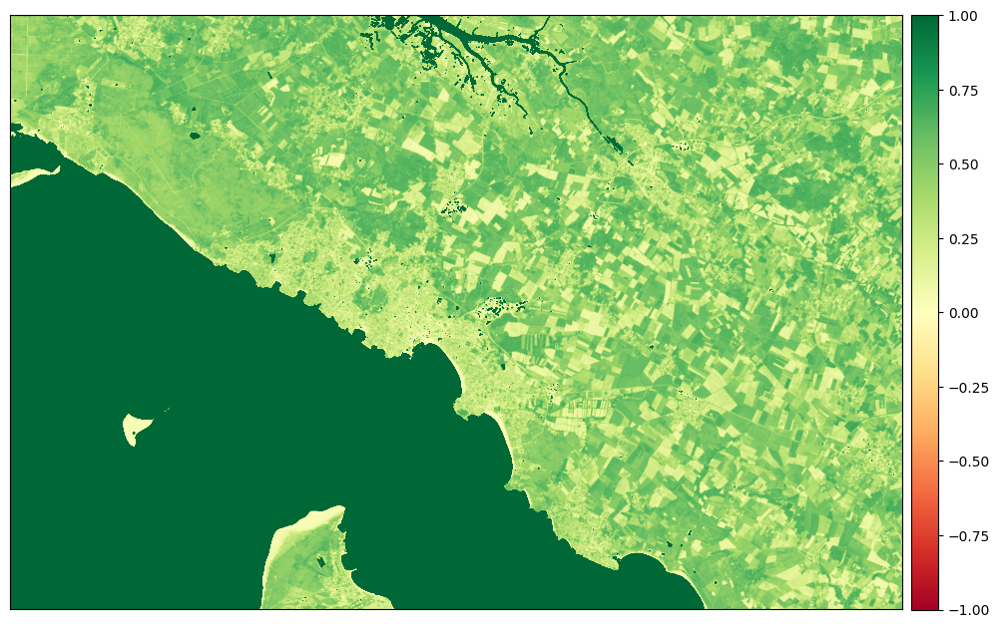

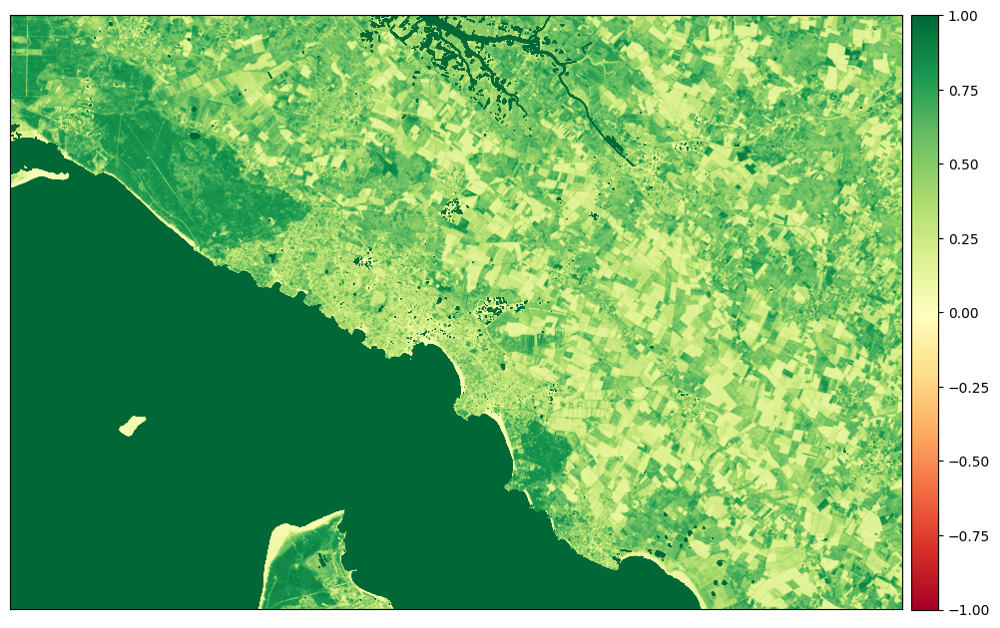

In [345]:
ep.plot_bands(
    arr = ndmi, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (12, 10)
)
ep.plot_bands(
    arr = ndmi_2, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (12, 10)
)
plt.show()

## 7 - Geology Indices:

In [346]:
cmr = np.divide(subset_stack_img[0], subset_stack_img[2])
cmr_2 = np.divide(subset_stack_img_2[0], subset_stack_img_2[2])

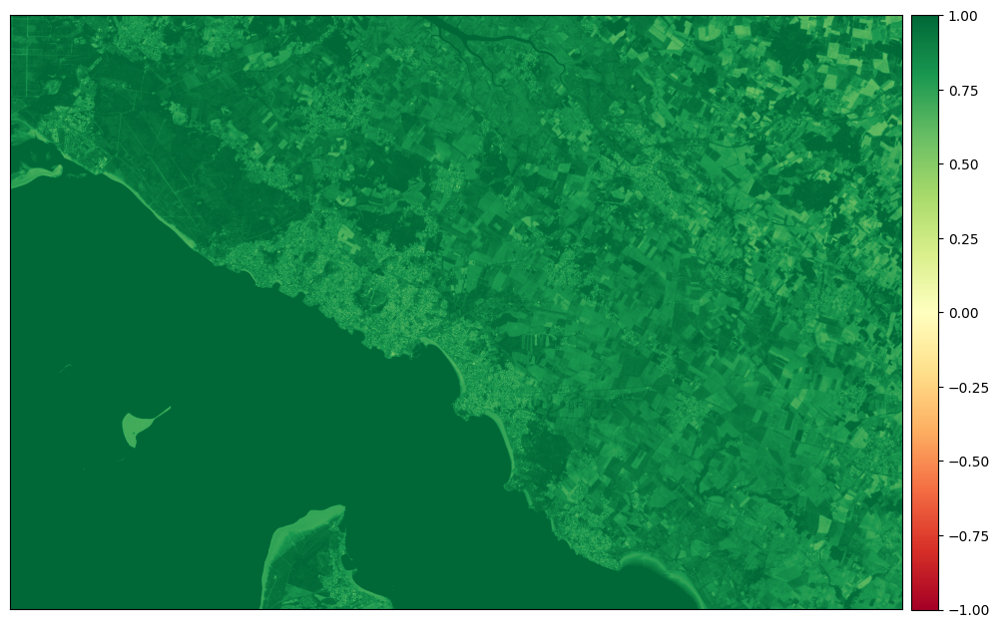

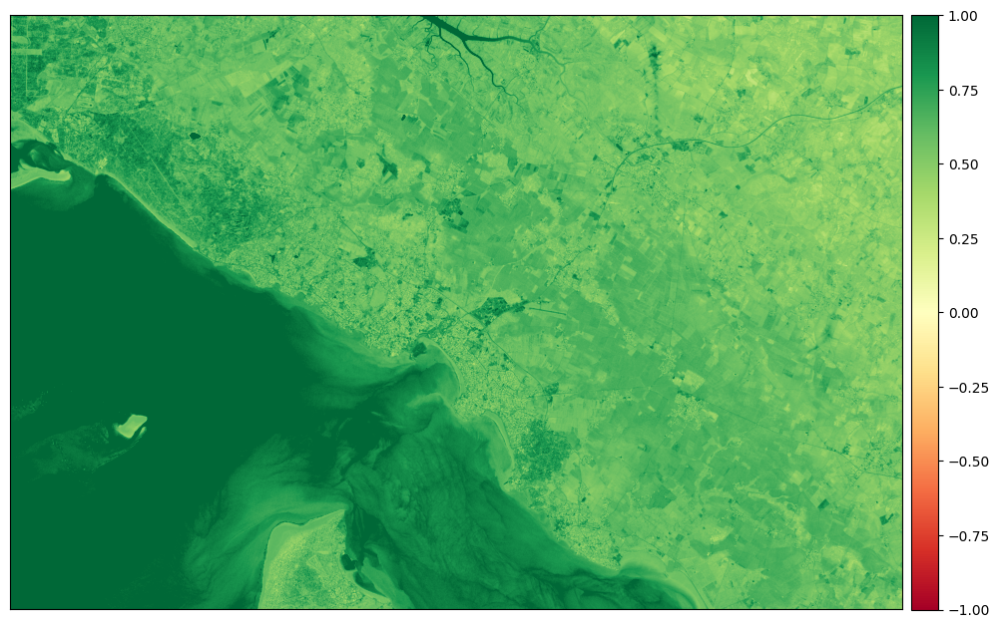

In [347]:
ep.plot_bands(
    arr = cmr, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (12, 10)
)

ep.plot_bands(
    arr = cmr_2, cmap = "RdYlGn",
    cols = 1, vmin = -1, vmax = 1,
    figsize = (12, 10)
)

plt.show()

# Partie 4 : Classification (random forest)

## 1- Préparation de la donnée : création d'étiquettes

In [348]:
# classes en fonction des valeurs de l'indice CMR
# ajuster ces valeurs en fonction de vos données spécifiques
threshold_mer = 3  # Ajustez ce seuil en fonction de vos données
threshold_terre = 10  # Ajustez ce seuil en fonction de vos données 

In [349]:
# Créez des masques pour chaque classe
#class_mer = np.logical_and(mndwi >= threshold_mer, mndwi < threshold_terre)
class_mer = mndwi < threshold_mer
class_terre = np.logical_and(mndwi <= threshold_terre, mndwi > threshold_mer)

#class_mer_2 = np.logical_and(mndwi_2 >= threshold_mer, mndwi_2 < threshold_terre)
class_mer_2 = mndwi_2 < threshold_mer
class_terre_2 = np.logical_and(mndwi_2 <= threshold_terre, mndwi_2 > threshold_mer)

In [350]:
# Appliquez les masques pour attribuer des étiquettes à chaque pixel
labels = np.zeros_like(mndwi, dtype=int)
labels[class_mer] = 1
labels[class_terre] = 0

labels_2 = np.zeros_like(mndwi_2, dtype=int)
labels_2[class_mer_2] = 1
labels_2[class_terre_2] = 0

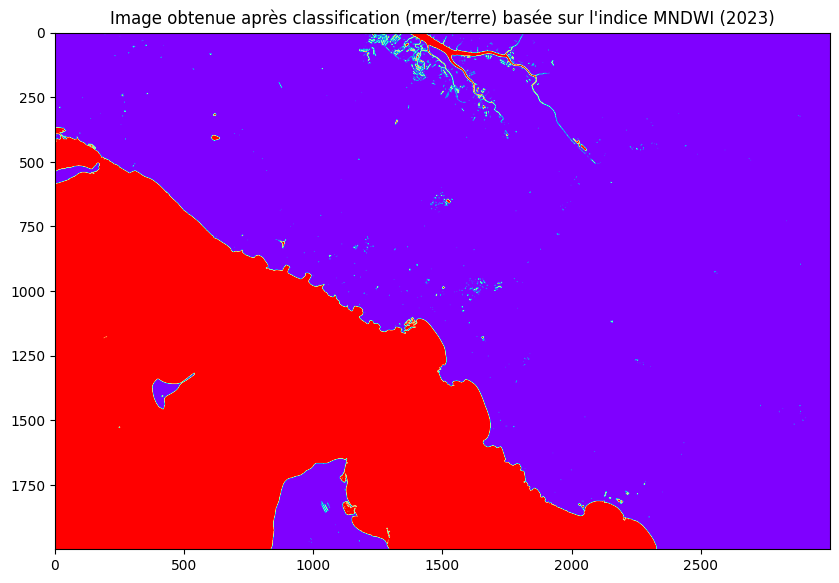

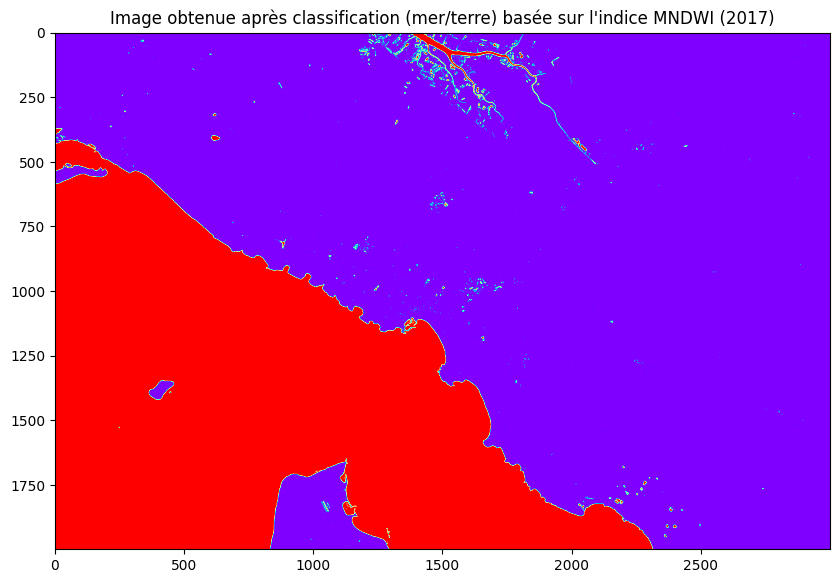

In [351]:
# Visualisez les classes sur l'image CMR 2023
plt.figure(figsize=(10, 10))
plt.imshow(labels, cmap='rainbow')  # Choisissez une colormap appropriée
plt.title('Image obtenue après classification (mer/terre) basée sur l\'indice MNDWI (2023)')
plt.show()

# Visualisez les classes sur l'image CMR 2017
plt.figure(figsize=(10, 10))
plt.imshow(labels_2, cmap='rainbow')  # Choisissez une colormap appropriée
plt.title('Image obtenue après classification (mer/terre) basée sur l\'indice MNDWI (2017)')
plt.show()

In [352]:
np.unique(labels,return_counts=True)

(array([0, 1]), array([4074466, 1925534], dtype=int64))

## 2 - Création d'un Ensemble d'Entraînement

In [353]:
pip install scikit-learn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [354]:
from sklearn.model_selection import train_test_split

In [355]:
# Concaténez les données des deux images et les étiquettes correspondantes
all_data = np.concatenate([ndvi.reshape(-1, 1), ndvi_2.reshape(-1, 1)], axis=1).flatten()
all_labels = np.concatenate([labels.flatten(), labels_2.flatten()]).flatten()

In [356]:
# Divisez les données en ensembles d'entraînement et de test
train_data, test_data, train_labels, test_labels = train_test_split(
    all_data, all_labels, test_size=0.2, random_state=42, stratify=all_labels
)

In [357]:
# Vérifiez la répartition des classes dans les ensembles d'entraînement et de test
unique_train, counts_train = np.unique(train_labels, return_counts=True)
unique_test, counts_test = np.unique(test_labels, return_counts=True)

print("Répartition des classes dans l'ensemble d'entraînement :", dict(zip(unique_train, counts_train)))
print("Répartition des classes dans l'ensemble de test :", dict(zip(unique_test, counts_test)))


Répartition des classes dans l'ensemble d'entraînement : {0: 6520691, 1: 3079309}
Répartition des classes dans l'ensemble de test : {0: 1630173, 1: 769827}


## 3 - Entraînement du Modèle de Classification : Random Forest

In [358]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [359]:
# Initialisez le modèle RandomForestClassifier
rf_model = RandomForestClassifier(n_estimators=10, random_state=42)

In [360]:
# Utiliser seulement 10% des données pour l'entraînement
sample_size = int(0.1 * len(train_data))
random_indices = np.random.choice(len(train_data), size=sample_size, replace=False)

In [361]:
rf_model.fit(train_data[random_indices].reshape(-1, 1), train_labels[random_indices])

RandomForestClassifier(n_estimators=10, random_state=42)

## 4 - Prédictions

In [362]:
# Faites des prédictions sur l'ensemble de test
test_predictions = rf_model.predict(test_data.reshape(-1, 1))

## 5 - Évaluation du Modèle

In [363]:
# Évaluez la performance du modèle
accuracy = accuracy_score(test_labels, test_predictions)
classification_rep = classification_report(test_labels, test_predictions)
confusion_mat = confusion_matrix(test_labels, test_predictions)

# Affichez les résultats
print("Accuracy:", accuracy)
print("\nClassification Report:\n", classification_rep)
print("\nConfusion Matrix:\n", confusion_mat)


Accuracy: 0.6487354166666667

Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.77      0.75   1630173
           1       0.45      0.40      0.42    769827

    accuracy                           0.65   2400000
   macro avg       0.59      0.58      0.58   2400000
weighted avg       0.64      0.65      0.64   2400000


Confusion Matrix:
 [[1250845  379328]
 [ 463707  306120]]



Matrice de confusion :
[[1250845  379328]
 [ 463707  306120]]


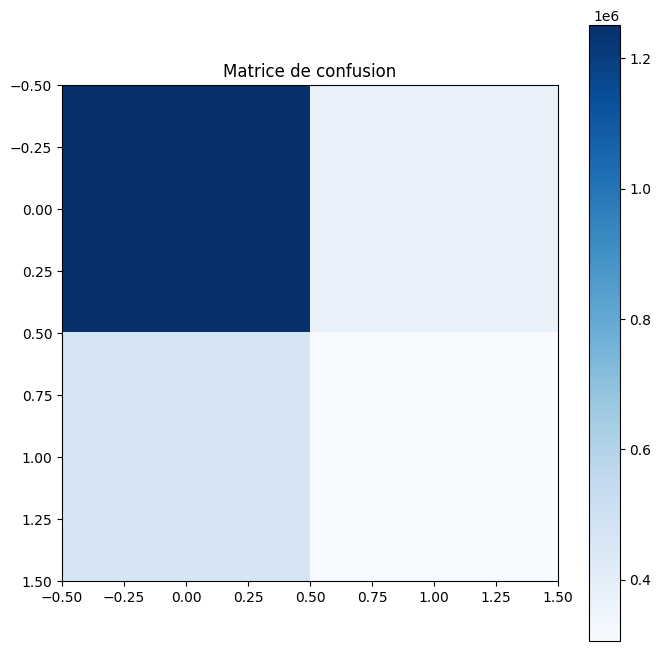

In [364]:
# Afficher la matrice de transition normalisée
print("\nMatrice de confusion :")
print(confusion_mat)

# Visualiser la matrice de transition sous forme de heatmap
plt.figure(figsize=(8, 8))
plt.imshow(confusion_mat, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Matrice de confusion')
plt.colorbar()
plt.show()


# Partie 5 : Changement LU/LC entre deux dates (CLC par ex)

Pour identifier les changements entre deux dates, vous pouvez utiliser les classifications que vous avez effectuées sur les images de chaque date. Vous avez déjà défini des classes (class_rock, class_vegetation, class_change) en fonction de l'indice CMR. Maintenant, vous pouvez comparer ces classes entre les deux dates pour détecter les changements. Voici comment vous pouvez procéder 

## 1 - Comparer les classes entre es 2 dates pour trouver le changement

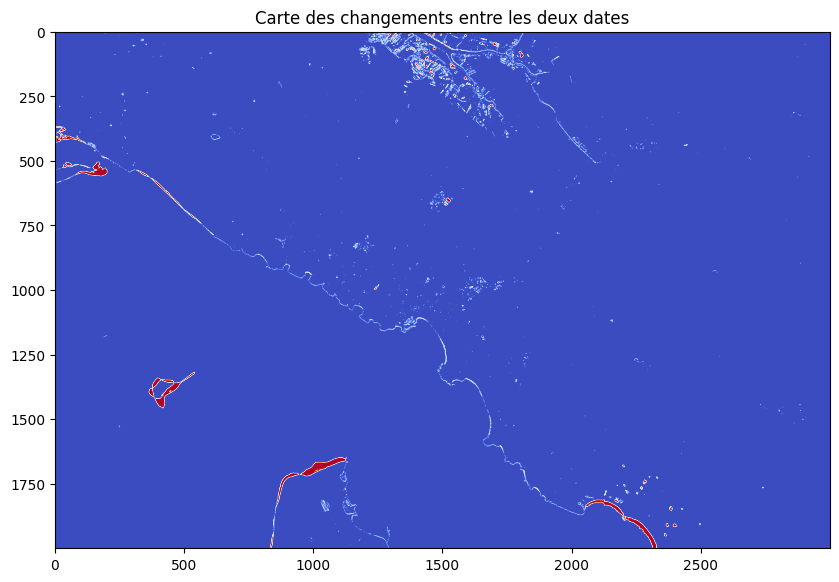

In [365]:
# Identifiez les pixels qui ont changé de classe entre les deux dates
changed_pixels = np.where(labels != labels_2)

# Créez une nouvelle image qui met en évidence les changements
change_map = np.zeros_like(labels)
change_map[changed_pixels] = 1

# Visualisez la carte des changements
plt.figure(figsize=(10, 10))
plt.imshow(change_map, cmap='coolwarm')  # Choisissez une colormap appropriée
plt.title('Carte des changements entre les deux dates')
plt.show()


## 2 - Affinez la détection des changements en filtrant les petits changements :

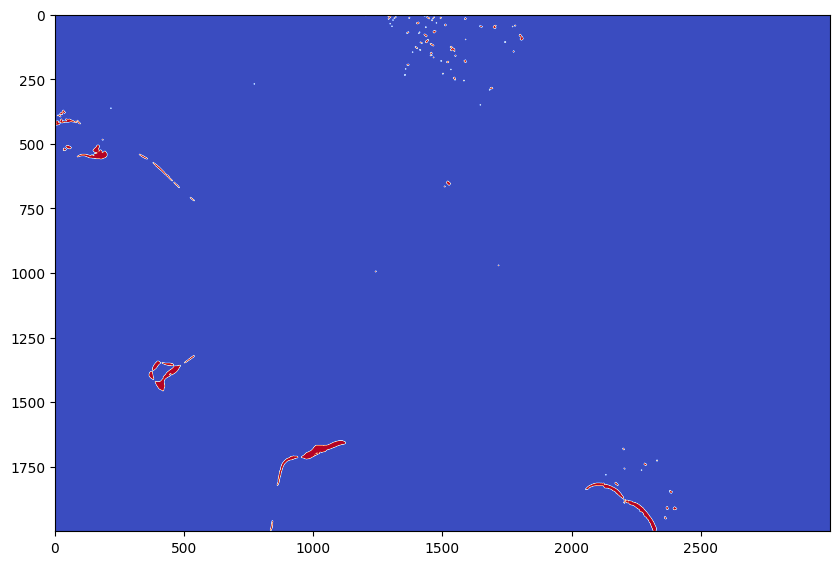

In [366]:
from scipy import ndimage

# Appliquez une opération de morphologie pour éliminer les petites zones de changement
change_map_filtered = ndimage.binary_opening(change_map, iterations=2)

# Visualisez la carte des changements filtrée
plt.figure(figsize=(10, 10))
plt.imshow(change_map_filtered, cmap='coolwarm')  # Choisissez une colormap appropriée
#plt.title('Carte des changements filtrée')
plt.show()


## 3 - Obtenez les statistiques sur les changements

In [367]:
# Calculez la superficie totale des changements
total_change_area = np.sum(change_map_filtered)

# Affichez les statistiques
print(f"Superficie totale des changements : {total_change_area} pixels")

Superficie totale des changements : 21768 pixels


# Partie 6 : Partie analyse des erreurs

Pour la partie d'analyse des erreurs, nous pouvons comparer les prédictions du modèle avec les étiquettes réelles et identifier les erreurs de classification

In [368]:
# Faites des prédictions sur l'ensemble de test
test_predictions = rf_model.predict(test_data.reshape(-1, 1))

# Identifiez les pixels mal classés
misclassified_pixels = np.where(test_predictions != test_labels)


In [369]:
subset_stack_img

array([[[1318, 1287, 1283, ..., 1206, 1286, 1346],
        [1286, 1300, 1306, ..., 1353, 1243, 1304],
        [1289, 1328, 1348, ..., 1600, 1461, 1352],
        ...,
        [1590, 1578, 1554, ..., 1285, 1262, 1281],
        [1590, 1612, 1608, ..., 1245, 1234, 1180],
        [1608, 1574, 1593, ..., 1257, 1218, 1205]],

       [[1440, 1466, 1493, ..., 1520, 1597, 1714],
        [1458, 1493, 1497, ..., 1597, 1542, 1644],
        [1449, 1546, 1560, ..., 1916, 1712, 1662],
        ...,
        [1650, 1620, 1610, ..., 1552, 1598, 1518],
        [1656, 1644, 1620, ..., 1524, 1571, 1394],
        [1628, 1666, 1625, ..., 1522, 1524, 1328]],

       [[1490, 1422, 1451, ..., 1363, 1523, 1566],
        [1389, 1414, 1458, ..., 1511, 1403, 1562],
        [1436, 1512, 1538, ..., 1916, 1624, 1565],
        ...,
        [1284, 1268, 1238, ..., 1452, 1465, 1426],
        [1295, 1287, 1264, ..., 1368, 1427, 1320],
        [1281, 1282, 1284, ..., 1390, 1364, 1280]],

       [[3172, 3120, 3386, ..., 4768,

In [370]:
misclassified_pixels


(array([      1,      10,      15, ..., 2399980, 2399994, 2399996],
       dtype=int64),)

In [371]:
len(misclassified_pixels)

1

# Partie 7 : Analyse de transition de classe

Pour effectuer une analyse de transition de classe, vous pouvez utiliser la matrice de transition. La matrice de transition montre comment les pixels se déplacent d'une classe à une autre entre deux dates. Elle est souvent utilisée pour évaluer la précision de la classification.

Matrice de transition entre les deux dates :
[[4055190   19276]
 [  21208 1904326]]

Matrice de transition normalisée :
[[0.99526907 0.00473093]
 [0.01101409 0.98898591]]


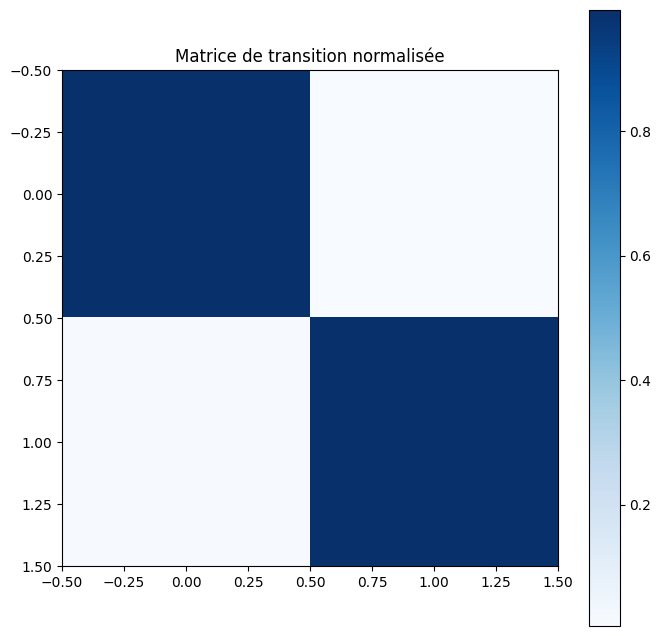

In [372]:
from sklearn.metrics import confusion_matrix

# Aplatir les étiquettes
labels_aplaties = labels.flatten()
labels_2_aplaties = labels_2.flatten()

# Calculer la matrice de confusion
confusion_mat_transition = confusion_matrix(labels_aplaties, labels_2_aplaties)

# Afficher la matrice de transition
print("Matrice de transition entre les deux dates :")
print(confusion_mat_transition)

# Normaliser la matrice pour obtenir des proportions au lieu de comptages
confusion_mat_transition_norm = confusion_mat_transition.astype('float') / confusion_mat_transition.sum(axis=1)[:, np.newaxis]

# Afficher la matrice de transition normalisée
print("\nMatrice de transition normalisée :")
print(confusion_mat_transition_norm)

# Visualiser la matrice de transition sous forme de heatmap
plt.figure(figsize=(8, 8))
plt.imshow(confusion_mat_transition_norm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Matrice de transition normalisée')
plt.colorbar()
plt.show()


Vrais positifs (VP) : 4076398 pixels ont été correctement classés comme n'ayant pas changé de classe entre les deux dates.
Faux négatifs (FN) : 0 pixels ont été classés à tort comme n'ayant pas changé de classe entre les deux dates.
Faux positifs (FP) : 19276 pixels ont été classés à tort comme ayant changé de classe entre les deux dates.
Vrais négatifs (VN) : 1904326 pixels ont été correctement classés comme ayant changé de classe entre les deux dates.

En regardant la matrice normalisée :
La sensibilité (taux de vrais positifs) est de 100%, ce qui signifie que tous les pixels qui ont réellement changé de classe ont été correctement identifiés.
La spécificité (taux de vrais négatifs) est également très élevée à 99,99%, ce qui signifie que la plupart des pixels qui n'ont pas changé de classe ont été correctement identifiés.
Le taux d'erreur global est très faible, à seulement 0,01%, indiquant une performance globale élevée du modèle.
Cela suggère que votre modèle de classification a bien fonctionné pour détecter les changements entre les deux dates, avec une très faible quantité de pixels mal classés.

# Partie 8 : Statistiques de superficie

In [295]:
# Calculez la superficie totale des changements
total_change_area = np.sum(change_map_filtered)

# Affichez les statistiques
print(f"Superficie totale des changements : {total_change_area} pixels")

Superficie totale des changements : 21768 pixels
